# Setup

## Import Packages

In [5]:
# import ESRI packages
import arcpy
import getpass
from arcpy import *
from arcpy.sa import *
from arcpy.da import *
from arcgis.gis import *
# import stats and plotting packages
import plotly as py
import plotly.graph_objs as go
import ipywidgets as widgets
import pandas as pd
import numpy as np

# plot settings
py.offline.init_notebook_mode(connected=True)

# set spatial reference
sr = arcpy.SpatialReference(26910)

# set environment variables
env.workspace = r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb'
env.overwriteOutput = True

# set local variables
Ecobject = r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb/Ecobject_LakeTahoeBasin'
Landfire = r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb/Landfire_BpS'
FRID15 =r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb/FRID_LakeTahoe_2015'
FRID17 = r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb/FRID_LakeTahoe_2017'
FSIM =r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb/HighSeverity_poly'
FRAP = r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb/FRAP_LakeTahoe'
TRPABndry = r'C:/GIS/PROJECT/SDE/SDE_Archive_2018.gdb/Jurisdictions/TRPA_bdy'

## Interactive Map

In [2]:
# login to AGOL
username = input("Username: ")
password = getpass.getpass("Password: ")
AGOL = GIS("http://trpa.maps.arcgis.com", username, password)
print("Successfully logged in to {} as {}".format(AGOL.properties.urlKey + '.' + AGOL.properties.customBaseUrl,
                                                 AGOL.users.me.username))

Username: mbindl
Password: ········
Successfully logged in to TRPA.maps.arcgis.com as mbindl


In [3]:
from arcgis.gis import GIS
from arcgis.features import SpatialDataFrame

sdf = SpatialDataFrame.from_featureclass(FRID17)
map1 = AGOL.map() #local region can be added in parentheses
map1
sdf.plot(kind='map', map_widget= map1)
map1

C:\Program Files\ArcGIS\Pro\bin\Python\envs\arcgispro-py3\lib\site-packages\arcgis\features\_data\geodataset\geodataframe.py:221: UserWarning:

SpatialDataFrame has been deprecated.  Please switch to the GeoAccessor/GeoSeriesAccessor.



MapView(layout=Layout(height='400px', width='100%'))

<Item title:"Lake Tahoe West" type:Web Map owner:mbindl>
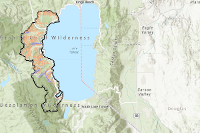

In [6]:
webmap_search = AGOL.content.search(query="Lake Tahoe West", item_type="Web Map")
webmap_search
webmap = webmap_search[0]
webmap

In [7]:
from arcgis.mapping import WebMap
LTW = WebMap(webmap)
LTW

MapView(hide_mode_switch=True, layout=Layout(height='400px', width='100%'))

In [8]:
for lyr in LTW.layers:
    print(lyr.title)

Proposed Action
Base Data
Slope Class
Canopy Hillshade
Hillshade


In [9]:
LTW.layers[0]

{
  "id": "Lake_Tahoe_West_Proposed_Action_3490",
  "layerType": "ArcGISMapServiceLayer",
  "url": "https://maps.trpa.org/server/rest/services/Lake_Tahoe_West_Proposed_Action/MapServer",
  "visibility": true,
  "visibleLayers": [
    0
  ],
  "opacity": 1,
  "title": "Proposed Action",
  "layers": [
    {
      "id": 0,
      "layerDefinition": {
        "source": {
          "type": "mapLayer",
          "mapLayerId": 0
        }
      },
      "name": "Proposed Forest Health Treatment",
      "minScale": 0,
      "maxScale": 0,
      "parentLayerId": -1,
      "defaultVisibility": true,
      "popupInfo": {
        "title": "Treatment Type: {Treatment} Thinning",
        "fieldInfos": [
          {
            "fieldName": "OBJECTID_1",
            "label": "OBJECTID_1",
            "isEditable": false,
            "visible": false
          },
          {
            "fieldName": "Id",
            "label": "Id",
            "isEditable": false,
            "visible": false,
        

### List Fields Ecobject

In [10]:
# For each field in the Ecobject feature class, print
#  the field name, type, and length.
fields = arcpy.ListFields(Ecobject)

for field in fields:
    print("{0} is a type of {1} with a length of {2}"
          .format(field.name, field.type, field.length))

OBJECTID is a type of OID with a length of 4
Shape is a type of Geometry with a length of 0
ECOREGION_DOMAIN is a type of String with a length of 4
ECOREGION_DIVISION is a type of String with a length of 3
ECOREGION_PROVINCE is a type of String with a length of 4
ECOREGION_SECTION is a type of String with a length of 5
ECOREGION_SUBSECTION is a type of String with a length of 6
CALVEGZONE is a type of String with a length of 1
TILE is a type of String with a length of 3
COVERTYPE is a type of String with a length of 3
REGIONAL_DOMINANCE_TYPE_1 is a type of String with a length of 3
OS_TREE_DIAMETER_CLASS_1 is a type of String with a length of 2
REGIONAL_DOMINANCE_TYPE_2 is a type of String with a length of 3
OS_TREE_DIAMETER_CLASS_2 is a type of String with a length of 2
REGIONAL_DOMINANCE_TYPE_3 is a type of String with a length of 2
CON_CFA is a type of String with a length of 2
HDW_CFA is a type of String with a length of 2
SHB_CFA is a type of String with a length of 2
HEB_CFA is a

# Vegetation Data Assessment

### WHR Type

In [11]:
# print field values
field = ['WHRTYPE']
with SearchCursor(Ecobject, field) as cursor:
    myValues = sorted({row[0] for row in cursor})
for value in myValues:
    print(value) 

ADS
AGS
ASP
BAR
BBR
EPN
JPN
JUN
LAC
LPN
LSG
MCP
MHC
MRI
PGS
RFR
SCN
SGB
SMC
URB
WFR
WTM


In [12]:
fields = ['Acres', 'WHRTYPE']
dictKeyAcre={}

with SearchCursor(Ecobject, fields, sql_clause=(None, 'ORDER BY TRPA_VegType ASC')) as cursor:
    for row in cursor:
        if row[1] != 'Water':
            if row[1] in dictKeyAcre:
                currentCount = dictKeyAcre[row[1]]
                dictKeyAcre[row[1]] = currentCount + row[0]
            else:
                dictKeyAcre[row[1]] = row[0]
x = []
y = []
for acre in dictKeyAcre:
    x.append(acre)
    y.append(dictKeyAcre[acre])

colors = ['#981557','#d7d79e','#9ed7c2','#e1e1e1','#292c5f','#ffff73','#e6e600','#a8a800','#0084a8','#b4d79e',
        '#a5f57a', '#0c224e','#00a820','#cdf57a', '#ff0000','#df73ff', '#737300','#c500ff', '#686868','#00a9e6','#ffd3e3']

# sns.palplot(sns.color_palette(colors))
# colors = sns.color_palette(colors)
# ax = sns.barplot(x=x, y=y, color=colors)

data = [go.Bar(x=x, y=y, width=0.5)]
layout = go.Layout(xaxis=dict(title='Vegetation Type',  ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000'), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='vegtype-bar')

### TRPA Veg Type

In [13]:
# print field values
field = ['TRPA_VegType']
with SearchCursor(Ecobject, field) as cursor:
    myValues = sorted({row[0] for row in cursor})
for value in myValues:
    print(value)        


Annual Grassland
Cushion Plant
Deciduous Riparian
Meadow
Red Fir Forest
Sagebrush Scrub
Shrub
Subalpine Forest
Water
Wetland
Yellow Pine Forest


In [14]:
fields = ['Acres', 'TRPA_VegType']
dictKeyAcre={}

with SearchCursor(Ecobject, fields, sql_clause=(None, 'ORDER BY TRPA_VegType ASC')) as cursor:
    for row in cursor:
        if row[1] != 'Water':
            if row[1] in dictKeyAcre:
                currentCount = dictKeyAcre[row[1]]
                dictKeyAcre[row[1]] = currentCount + row[0]
            else:
                dictKeyAcre[row[1]] = row[0]
x = []
y = []
for acre in dictKeyAcre:
    x.append(acre)
    y.append(dictKeyAcre[acre])

colors = ['#981557','#d7d79e','#9ed7c2','#e1e1e1','#292c5f','#ffff73','#e6e600','#a8a800','#0084a8','#b4d79e',
        '#a5f57a', '#0c224e','#00a820','#cdf57a', '#ff0000','#df73ff', '#737300','#c500ff', '#686868','#00a9e6','#ffd3e3']

# sns.palplot(sns.color_palette(colors))
# colors = sns.color_palette(colors)
# ax = sns.barplot(x=x, y=y, color=colors)

data = [go.Bar(x=x, y=y, width=0.5)]
layout = go.Layout(xaxis=dict(title='Vegetation Type',  ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000'), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='vegtype-bar')

## Regional Dominance Type

In [13]:
field = ['REGIONAL_DOMINANCE_TYPE_1']
with SearchCursor(Ecobject, field) as cursor:
    myValues = sorted({row[0] for row in cursor})
for value in myValues:
    print(value)        

AC
AX
BA
BB
BL
BM
BQ
BS
BX
CG
CH
CM
CN
CP
CV
CX
CY
EP
HG
HJ
HM
IB
IC
IG
JP
KQ
LP
MF
MH
NR
QO
QQ
QX
RF
SA
TA
TS
TV
UB
WA
WB
WF
WJ
WL
WW


In [14]:
fields = ['Acres', 'REGIONAL_DOMINANCE_TYPE_1']
dictKeyAcre={}

with SearchCursor(Ecobject, fields, sql_clause=(None, 'ORDER BY TRPA_VegType ASC')) as cursor:
    for row in cursor:
        if row[1] != 'WB':
            if row[1] in dictKeyAcre:
                currentCount = dictKeyAcre[row[1]]
                dictKeyAcre[row[1]] = currentCount + row[0]
            else:
                dictKeyAcre[row[1]] = row[0]
x = []
y = []
for acre in dictKeyAcre:
    x.append(acre)
    y.append(dictKeyAcre[acre])

colors = ['#981557','#d7d79e','#9ed7c2','#e1e1e1','#292c5f','#ffff73','#e6e600','#a8a800','#0084a8','#b4d79e',
        '#a5f57a', '#0c224e','#00a820','#cdf57a', '#ff0000','#df73ff', '#737300','#c500ff', '#686868','#00a9e6','#ffd3e3']

# sns.palplot(sns.color_palette(colors))
# colors = sns.color_palette(colors)
# ax = sns.barplot(x=x, y=y, color=colors)

data = [go.Bar(x=x, y=y, width=0.5)]
layout = go.Layout(xaxis=dict(title='Vegetation Type',  ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000'), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='vegtype-bar')

## Ecobject WHR Type Summary

In [15]:
# Run search cursor to add up acreage of each vegetation type.
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRTYPE']) as cursor:
    ads = ags = asp = bar = bbr = epn = jpn = jun = lac = lpn = lsg = mcp = mhc = mri = pgs = rfr = scn = sgb = smc = urb = wtm = wfr = total = 0    
    for row in cursor:     
        if row[1] !='LAC':
            total += row[0]
            if row[1] == 'ADS':
                ads += row[0]
            elif row[1] == 'AGS':
                ags += row[0]
            elif row[1] == 'ASP':
                asp += row[0]
            elif row[1] == 'BAR':
                bar += row[0]
            elif row[1] == 'BBR':
                bbr += row[0]
            elif row[1] == 'EPN':
                epn += row[0]
            elif row[1] == 'JPN':
                jpn += row[0]
            elif row[1] == 'JUN':
                jun += row[0]
            elif row[1] == 'LPN':
                lpn += row[0]
            elif row[1] == 'LSG':
                lsg += row[0]
            elif row[1] == 'MCP':
                mcp += row[0]
            elif row[1] == 'MHC':
                mhc += row[0]
            elif row[1] == 'MRI':
                mri += row[0] 
            elif row[1] == 'PGS':
                pgs += row[0]
            elif row[1] == 'RFR':
                rfr += row[0]
            elif row[1] == 'SCN':
                scn += row[0]
            elif row[1] == 'SGB':
                sgb += row[0]
            elif row[1] == 'SMC':
                smc += row[0]
            elif row[1] == 'URB':
                urb += row[0]
            elif row[1] == 'WTM':
                wtm += row[0]
            elif row[1] == 'WFR':
                wfr += row[0]
print("A total of {:,} acres were assessed.".format(int(total)))

A total of 202,109 acres were assessed.


In [16]:
labels = ['Alpine Dwarf Shrub', 'Annual Grassland','Aspen','Barren','Bitterbrush', 'Eastside Pine','Jeffrey Pine','Juniper',
          'Lacustrine','Lodgepole Pine','Low Sage','Montane Chaparral','Montane Hardwood-Conifer','Montane Riparian',
          'Perrenial Grassland','Red Fir','Subalpine Conifer','Sagebrush','Sierran Mixed Conifer',
          'Urban', 'Wet Meadow', 'White Fir']
values = [(ads/total),(ags/total),(asp/total),(bar/total),(bbr/total),(epn/total),(jpn/total),(jun/total),(lac/total),
          (lpn/total),(lsg/total),(mcp/total),(mhc/total),(mri/total),(pgs/total),(rfr/total),(scn/total),(sgb/total),
          (smc/total),(urb/total),(wtm/total),(wfr/total)]
colors = ['rgb(152, 21, 87)','rgb(215, 215, 158)','rgb(158, 215, 194)','rgb(225, 225, 225)','rgb(41, 44, 95)','rgb(255, 255, 115)',
          'rgb(230, 230, 0)','rgb(168, 168, 0)','rgb(0, 132, 168)','rgb(255, 170, 0)','rgb(180, 215, 158)','rgb(165, 245, 122)', 'rgb(12, 34,78)',
          'rgb(0, 168, 32)', 'rgb(205, 245, 122)', 'rgb(255, 0, 0)','rgb(223, 115, 255)', 'rgb(115, 115, 0)','rgb(197, 0, 255)', 'rgb(104, 104, 104)',
          'rgb(0, 169, 230)', 'rgb(255, 211, 227)']
trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent', textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))
py.offline.iplot([trace], filename='veg-pie')

### Add Field

In [17]:
## Add Field
# Set local variables
fieldName = "WHRTYPE"
fieldType = "text"
fieldPrecision = ""
fieldScale = ""
fieldLength = "50"
fieldAlias = "WHR Type"

# Execute AddField twice for two new fields
arcpy.AddField_management(Landfire, fieldName, fieldType, fieldPrecision, fieldScale, fieldLength, fieldAlias, field_is_nullable="NULLABLE")

TypeError: 'module' object is not callable

TypeError: 'module' object is not callable

TypeError: 'module' object is not callable

TypeError: 'module' object is not callable

TypeError: 'module' object is not callable

TypeError: 'module' object is not callable

TypeError: 'module' object is not callable

TypeError: 'module' object is not callable

ExecuteError: Failed to execute. Parameters are not valid.
ERROR 000012: WHRTYPE already exists
Failed to execute (AddField).


## Ecobject WHR Type to TRPA Vegetation Association

In [ ]:
fields = ['WHRTYPE', 'TRPA_VegType']
# Create update cursor for feature class 
with arcpy.da.UpdateCursor(Ecobject, fields) as cursor:
    for row in cursor:
        # translate 'WHRTYPE' values to 'TRPA_VegType'
        if (row[0] == 'AGS'):
            row[1] = 'Annual Grassland'
        elif (row[0] == 'BAR'):
            row[1] = 'Cushion Plant'
        elif (row[0] in ('ASP', 'MHC', 'MRI')):
            row[1] = 'Deciduous Riparian'
        elif (row[0] == 'PGS'):
            row[1] = 'Meadow'
        elif( row[0] in ('RFR', 'LPN', 'JUN')):
            row[1] = 'Red Fir Forest'
        elif (row[0] in ('BBR', 'LSG', 'SGB')):
            row[1] = 'Sagebrush Scrub'
        elif (row[0] in ('ADS', 'MCP')):
            row[1] = 'Shrub'
        elif (row[0] == 'SCN'):
            row[1] = 'Subalpine Forest'
        elif (row[0] == 'WTM'):
            row[1] = 'Wetland'
        elif (row[0] in ('EPN', 'JPN', 'SMC', 'WFR')):
            row[1] = 'Yellow Pine Forest'
        elif (row[0] == 'LAC'):
            row[1] = 'Water' 
        else:
            row[1] = ''
        # Update the cursor with the updated list
        cursor.updateRow(row)

In [ ]:
field = ['TRPA_VegType']
with arcpy.da.SearchCursor(Ecobject, field) as cursor:
    for row in cursor:
        print(row)

In [ ]:
fields = ['Acres', 'TRPA_VegType']
dictKeyAcre={}

with SearchCursor(Ecobject, fields, sql_clause=(None, 'ORDER BY TRPA_VegType ASC')) as cursor:
    for row in cursor:
        if row[1] != 'Water':
            if row[1] in dictKeyAcre:
                currentCount = dictKeyAcre[row[1]]
                dictKeyAcre[row[1]] = currentCount + row[0]
            else:
                dictKeyAcre[row[1]] = row[0]
x = []
y = []
for acre in dictKeyAcre:
    x.append(acre)
    y.append(dictKeyAcre[acre])

data = [go.Bar(x=x, y=y, width=0.5)]
layout = go.Layout(xaxis=dict(title='Vegetation Type', autotick=False, ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000'), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='vegtype-bar')

## Landfire BpS

In [ ]:
field = ['GROUPNAME']
with arcpy.da.SearchCursor(Landfire, field) as cursor:
    myValues = sorted({row[0] for row in cursor})
for value in myValues:
    print(value)     

##  Ecobject to TRPA Veg Type

### Calculate percentage of each Vegetaiton Type

In [ ]:
labels = ['Annual Grassland','Cushion Plant','Deciduous Riparian','Meadow','Red Fir Forest','Sagebrush Scrub','Shrub','Subalpine Forest','Wetland','Yellow Pine Forest']
values = [(ag/total),(cp/total),(dr/total),(md/total),(rf/total),(ss/total),(sh/total),(sa/total),(wt/total),(yp/total)]
colors = ['rgb(205, 205, 102)','rgb(204, 204, 204)','rgb(158, 215, 194)','rgb(137, 205, 102)','rgb(168, 56, 0)',
          'rgb(180, 215, 158)','rgb(170, 102, 205)','rgb(214, 157, 188)''rgb(0, 132, 168)','rgb(122, 182, 245)','rgb(245, 245, 122)']
trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent', textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))
py.offline.iplot([trace], filename='veg-pie')

In [ ]:
field = ['TRPA_VegType']
with arcpy.da.SearchCursor(Ecobject, field) as cursor:
    myValues = sorted({row[0] for row in cursor})
for value in myValues:
    print(value)

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'TRPA_VegType']) as cursor:
    ag = cp = dr = md = rf = ss = sh = sa = wt = yp = total = 0    
    for row in cursor:     
        if row[1] != "Water":
            total += row[0]
            if row[1] == "Annual Grassland":
                ag += row[0]
            elif row[1] == 'Cushion Plant':
                cp += row[0]
            elif row[1] == 'Deciduous Riparian':
                dr += row[0]
            elif row[1] == 'Meadow':
                md += row[0]
            elif row[1] == 'Red Fir Forest':
                rf += row[0]
            elif row[1] == 'Sagebrush Scrub':
                ss += row[0]
            elif row[1] == 'Shrub':
                sh += row[0]
            elif row[1] == 'Subalpine Forest':
                sa += row[0]
            elif row[1] == 'Wetland':
                wt += row[0]
            elif row[1] == 'Yellow Pine Forest':
                yp += row[0]          
print(total)

## Historic Range of Vegetation - LANDFIRE BpS

### General vegetation type crosswalk.
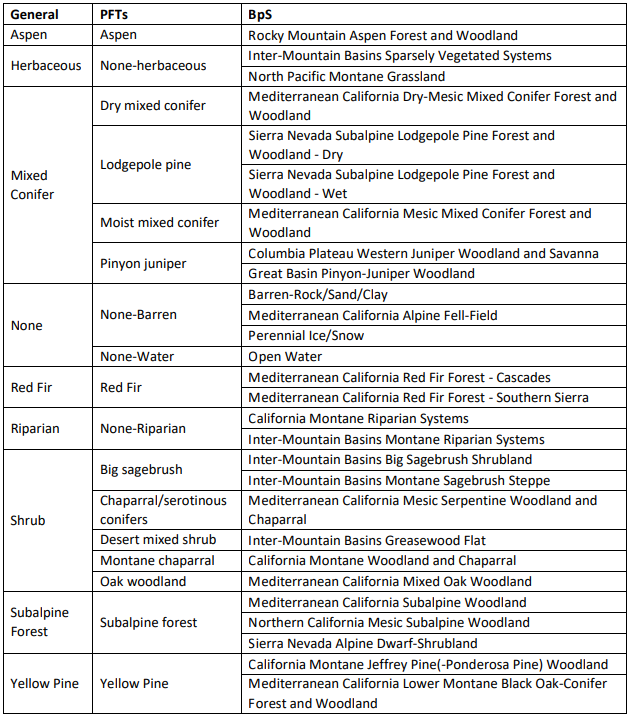


WHRTYPES:
http://frap.fire.ca.gov/projects/frap_veg/classification

In [ ]:
fields = ['Acres', 'GROUPNAME']
dictKeyAcre={}

with SearchCursor(Landfire, fields, sql_clause=(None, 'ORDER BY GROUPNAME ASC')) as cursor:
    for row in cursor:
        if row[1] != 'Open Water':
            if row[1] in dictKeyAcre:
                currentCount = dictKeyAcre[row[1]]
                dictKeyAcre[row[1]] = currentCount + row[0]
            else:
                dictKeyAcre[row[1]] = row[0]
x = []
y = []
for acre in dictKeyAcre:
    x.append(acre)
    y.append(dictKeyAcre[acre])

data = [go.Bar(x=x, y=y, width=0.5)]
layout = go.Layout(xaxis=dict(title='Vegetation Type',  ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000'), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='vegtype-bar')

## Landfire to TRPA Veg Type

### Landfire to TRPA Veg Type

In [ ]:
fields = ['GROUPNAME', 'TRPA_VegType']
# Create update cursor for feature class 
with arcpy.da.UpdateCursor(Landfire, fields) as cursor:
    for row in cursor:
        # translate 'WHRTYPE' values to 'TRPA_VEG_TYPE'
        if row[0] in (''):
            row[1] = 'Annual Grassland'
        elif row[0] in ('Sparsely Vegetated', ' PerennialIce/Snow','Barren-Rock/Sand/Clay'):
            row[1] = 'Cushion Plant'
        elif row[0] in ('Sargents Cypress-LeatherOak-3', 'Quaking Aspen-Subalpine Fir-Douglas Fir-3', 'Quaking Aspen-4',
                       'Black Cottonwood-Arroyo Willow-Madrone-3', 'Black Cottonwood-Narrowleaf Willow-3',
                       'Heather Moss-Arctic Willow-5', 'Oregon White Oak-RoemersFescue-Oatgrass-1'):
            row[1] = 'Deciduous Riparian'
        elif row[0] in ('Wildrye-Idaho Fescue-2'):
            row[1] = 'Meadow'
        elif row[0] in ('Red Fir-White Fir-1', 'Red Fir-Western White Pine-3', 'Lodgepole Pine-Foxtail Pine-1',
                        'Lodgepole Pine-Pinemat Manzanita-3', 'Western Juniper-Low Sage-3'):
            row[1] = 'Red Fir Forest'
        elif row[0] in ('Wyoming Big Sage-Rubber Rabbitbrush-4', 'Western Yarrow-Rothrock Sage-2', 
                       'Mountain Sagebrush-Bluebunch Wheatgrass-Idaho Fescue-4','Curlleaf Mountain Mahogany-Mountain Big Sagebrush-3',
                       'Greasewood-Shadscale-5'):
            row[1] = 'Sagebrush Scrub'
        elif row[0] in ('Pointleaf Manzanita-Desert Ceanothus-Birchleaf Mountain Mahogany-4', 'Chamise-Manzanita-4',
                       'Greenleaf Manzanita-Whitethorn Ceanothus-3','Pink Mountain Heath-Wax Currant-5'):
            row[1] = 'Shrub'
        elif row[0] in ('Mountain Hemlock-Lodgepole Pine-5'):
            row[1] = 'Subalpine Forest'
        elif row[0] in (''):
            row[1] = 'Wetland'
        elif row[0] in ('Whitebark Pine-3', 'Western Juniper-Low Sage-3', 'Singleleaf Pinyon-Utah Juniper-3', 
                        'Ponderosa Pine-Incense Cedar-1', 'Ponderosa Pine-California Black Oak-1', 
                        'Douglas Fir-White Fir-Sugar Pine-1','Jeffrey Pine-1'):
            row[1] = 'Yellow Pine Forest'
        elif row[0] in ('Open Water'):
            row[1] = 'Water' 
        # Update the cursor with the updated list
        cursor.updateRow(row)

### Landfire BpS to WHR Type

In [ ]:
fields = ['GROUPNAME', 'WHRTYPE']
# Create update cursor for feature class 
with arcpy.da.UpdateCursor(Landfire, fields) as cursor:
    for row in cursor:
        # translate 'WHRTYPE' values to 'TRPA_VegType'
        if (row[0] == 'Sparsely Vegetated'):
            row[1] = 'ADS'
        elif (row[0] in ('Quaking Aspen-4', 'Quaking Aspen-Subalpine Fir-Douglas Fir-3')):
            row[1] = 'ASP'
        elif (row[0] in (' PerennialIce/Snow', 'Barren-Rock/Sand/Clay')):
            row[1] = 'BAR'
        elif( row[0] in ('Jeffrey Pine-1')):
            row[1] = 'JPN'
        elif (row[0] in ('Singleleaf Pinyon-Utah Juniper-3', 'Western Juniper-Low Sage-3')):
            row[1] = 'JUN'
        elif (row[0] == 'Open Water'):
            row[1] = 'LAC' 
        elif (row[0] in ('Lodgepole Pine-Foxtail Pine-1', 'Lodgepole Pine-Pinemat Manzanita-3', 'Mountain Hemlock-Lodgepole Pine-5')):
            row[1] = 'LPN'
        elif (row[0] == 'Wyoming Big Sage-Rubber Rabbitbrush-4'):
            row[1] = 'LSG'
        elif (row[0] in ('Greenleaf Manzanita-Whitethorn Ceanothus-3', 'Pink Mountain Heath-Wax Currant-5',
                         'Pointleaf Manzanita-Desert Ceanothus-Birchleaf Mountain Mahogany-4')):
            row[1] = 'MCP'
        elif (row[0] in ('Oregon White Oak-RoemersFescue-Oatgrass-1', 'Ponderosa Pine-California Black Oak-1', 
                         'Ponderosa Pine-Incense Cedar-1', 'Sargents Cypress-LeatherOak-3')):
            row[1] = 'MHC'
        elif (row[0] in ('Black Cottonwood-Arroyo Willow-Madrone-3', 'Black Cottonwood-Narrowleaf Willow-3')):
            row[1] = 'MRI'
        elif (row[0] in ('Wildrye-Idaho Fescue-2')):
            row[1] = 'PGS'
        elif (row[0] in ('Red Fir-Western White Pine-3', 'Red Fir-White Fir-1')):
            row[1] = 'RFR'
        elif (row[0] in ('Quaking Aspen-Subalpine Fir-Douglas Fir-3', 'Whitebark Pine-3')):
            row[1] = 'SCN'
        elif (row[0] in ('Curlleaf Mountain Mahogany-Mountain Big Sagebrush-3', 'Greasewood-Shadscale-5', 
                         'Mountain Sagebrush-Bluebunch Wheatgrass-Idaho Fescue-4', 'Western Yarrow-Rothrock Sage-2')):
            row[1] = 'SGB'
        elif row[0] = ''
            row[1] = 'SMC'
        elif (row[0] == 'Douglas Fir-White Fir-Sugar Pine-1'):
            row[1] = 'WFR'   
        else:
            row[1] = ''
        # Update the cursor with the updated list
        cursor.updateRow(row)

### Landfire WHR Type Summary

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Landfire, ['Acres', 'WHRTYPE']) as cursor:
    ads = ags = asp = bar = bbr = epn = jpn = jun = lac = lpn = lsg = mcp = mhc = mri = pgs = rfr = scn = sgb = smc = urb = wtm = wfr = total = 0    
    for row in cursor:     
        if row[1] != 'LAC':
            total += row[0]
            if row[1] == 'ADS':
                ads += row[0]
            elif row[1] == 'AGS':
                ags += row[0]
            elif row[1] == 'ASP':
                asp += row[0]
            elif row[1] == 'BAR':
                bar += row[0]
            elif row[1] == 'BBR':
                bbr += row[0]
            elif row[1] == 'EPN':
                epn += row[0]
            elif row[1] == 'JPN':
                jpn += row[0]
            elif row[1] == 'JUN':
                jun += row[0]
            elif row[1] == 'LPN':
                lpn += row[0]
            elif row[1] == 'LSG':
                lsg += row[0]
            elif row[1] == 'MCP':
                mcp += row[0]
            elif row[1] == 'MHC':
                mhc += row[0]
            elif row[1] == 'MRI':
                mri += row[0] 
            elif row[1] == 'PGS':
                pgs += row[0]
            elif row[1] == 'RFR':
                rfr += row[0]
            elif row[1] == 'SCN':
                scn += row[0]
            elif row[1] == 'SGB':
                sgb += row[0]
            elif row[1] == 'SMC':
                smc += row[0]
            elif row[1] == 'URB':
                urb += row[0]
            elif row[1] == 'WTM':
                wtm += row[0]
            elif row[1] == 'WFR':
                wfr += row[0]
print("A total of {:,} acres were assessed.".format(int(total)))

### Landfire reclassified to WHR Type

In [ ]:
labels = ['Alpine Dwarf Shrub', 'Annual Grassland','Aspen','Barren','Bitterbrush','Eastside Pine','Jeffrey Pine',
          'Juniper','Lacustrine','Lodgepole Pine','Low Sage','Montane Chaparral','Montane Hardwood-Conifer',
          'Montane Riparian','Perrenial Grassland','Red Fir','Subalpine Conifer', 'Sagebrush','Sierran Mixed Conifer',
          'Urban', 'Wet Meadow', 'White Fir']
values = [(ads/total),(ags/total),(asp/total),(bar/total),(bbr/total),(epn/total),(jpn/total),(jun/total),(lac/total),
          (lpn/total),(lsg/total),(mcp/total),(mhc/total),(mri/total),(pgs/total),(rfr/total),(sgb/total),(scn/total),
          (smc/total),(urb/total),(wtm/total),(wfr/total)]
colors = ['rgb(352, 21, 87)','rgb(215, 215, 158)','rgb(158, 215, 194)','rgb(225, 225, 225)','rgb(41, 44, 95)', 'rgb(255, 255, 115)',
          'rgb(230, 230, 0)','rgb(168, 168, 0)','rgb(0, 132, 168)','rgb(255, 170, 0)','rgb(180, 215, 158)','rgb(336, 14, 93)', 'rgb(12, 34,78)',
          'rgb(0, 168, 32)', 'rgb(205, 245, 122)', 'rgb(255, 0, 0)', 'rgb(137, 205, 102)', 'rgb(115, 115, 0)', 'rgb(197, 0, 255)', 'rgb(104, 104, 104)',
          'rgb(0, 169, 230)', 'rgb(255, 211, 127)']
trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent', textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))
py.offline.iplot([trace], filename='veg-pie')

### Calculate Acres

In [ ]:
fields = ["SHAPE@AREA","Acres"]
with arcpy.da.UpdateCursor(Landfire_BpS, fields)as cursor:
    for row in cursor:
        AreaValue = float(row[0]) #Read area value as double
        row[1] = (AreaValue * 0.000247105) #Write area value to field
        cursor.updateRow(row)

### Landfire - Acres of TRPA Veg Type

In [ ]:
fields = ['Acres', 'TRPA_VegType']
dictKeyAcre={}

with SearchCursor(Landfire, fields, sql_clause=(None, 'ORDER BY TRPA_VegType ASC')) as cursor:
    for row in cursor:
        if row[1] != 'Water':
            if row[1] in dictKeyAcre:
                currentCount = dictKeyAcre[row[1]]
                dictKeyAcre[row[1]] = currentCount + row[0]
            else:
                dictKeyAcre[row[1]] = row[0]
x = []
y = []
for acre in dictKeyAcre:
    x.append(acre)
    y.append(dictKeyAcre[acre])

data = [go.Bar(x=x, y=y, width=0.5)]
layout = go.Layout(xaxis=dict(title='Vegetation Type', autotick=False, ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000'), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='veg-bar')

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Landfire, ['Acres', 'TRPA_VegType']) as cursor:
    ag = cp = dr = md = rf = ss = sh = sa = wt = yp = total = 0    
    for row in cursor:     
        if row[1] != "Water":
            total += row[0]
            if row[1] == "Annual Grassland":
                ag += row[0]
            elif row[1] == 'Cushion Plant':
                cp += row[0]
            elif row[1] == 'Deciduous Riparian':
                dr += row[0]
            elif row[1] == 'Meadow':
                md += row[0]
            elif row[1] == 'Red Fir Forest':
                rf += row[0]
            elif row[1] == 'Sagebrush Scrub':
                ss += row[0]
            elif row[1] == 'Shrub':
                sh += row[0]
            elif row[1] == 'Subalpine Forest':
                sa += row[0]
            elif row[1] == 'Wetland':
                wt += row[0]
            elif row[1] == 'Yellow Pine Forest':
                yp += row[0]          
print("A total of {:,} acres were assessed.".format(int(total)))

### Landfire Reclassified to TRPA Veg Type

In [ ]:
labels = ['Annual Grassland','Cushion Plant','Deciduous Riparian','Meadow','Red Fir Forest','Sagebrush Scrub','Shrub','Subalpine Forest','Wetland','Yellow Pine Forest']
values = [(ag/total),(cp/total),(dr/total),(md/total),(rf/total),(ss/total),(sh/total),(sa/total),(wt/total),(yp/total)]
colors = ['rgb(205, 205, 102)','rgb(204, 204, 204)','rgb(158, 215, 194)','rgb(137, 205, 102)','rgb(168, 56, 0)',
          'rgb(180, 215, 158)','rgb(170, 102, 205)','rgb(214, 157, 188)''rgb(0, 132, 168)','rgb(122, 182, 245)','rgb(245, 245, 122)']
trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent', textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

## Seral Stage

### Seral Stage Defined

Forest management activities will encourage the development and persistence of all seral stages across the Lake Tahoe Basin, creating spatial complexity and promoting the development of old-growth forests. Seral stage refers to overstory tree diameter at breast height (DBH, inches) and overstory tree canopy from above (% canopy).

Early-seral Open Canopy (<=5" DBH & <=40% canopy for Yellow Pine, <=50% for all other forested types)

Early-seral Closed Canopy (<=5" DBH & >40% canopy for Yellow Pine, >50% for all other forested types)

Mid-seral Open Canopy (5-25” DBH & <=40% canopy for Yellow Pine, <=50% for all other forested types)

Mid-seral Closed Canopy (5-25" DBH & >40% canopy for Yellow Pine, >50% for all other forested types)

Late-seral Open Canopy (>25” DBH & <=40% canopy for Yellow Pine, <=50% for all other forested types)

Late-seral Closed Canopy (>25” DBH & >40% canopy for Yellow Pine, >50% for all other forested types)


### Classify Seral Stage using Ecobject Data

In [1]:
fields = ['QMD', 'Can_Cov', 'SeralStage','WHRTYPE']
# Create update cursor for feature class 
with arcpy.da.UpdateCursor(Ecobject, fields) as cursor:
    # set cursor 
    for row in cursor:
        # seral stage by species group
        if (row[3] in ("JPN", "EPN", "JUN")):
            # QMD and Canopy Cover thresholds for 
            if (row[0] <= 12 and row[1] > 40):
                row[2] = 'Early Seral Closed'
            elif (row[0] <= 12 and row[1] <= 40):
                row[2] = 'Early Seral Open'
            elif (row[0] > 12 and row[0] <= 25 and row[1] > 40):
                row[2] = 'Mid Seral Closed'
            elif (row[0] > 12 and row[0] <= 25 and row[1] <= 40):
                row[2] = 'Mid Seral Open'
            elif (row[0] > 25 and row[1] > 40):
                row[2] = 'Late Seral Closed'
            elif (row[0] > 25 and row[1] <= 40):
                row[2] = 'Late Seral Open'
        # seral stage ranges for 
        if (row[3] in ("SMC", "WFR", "RFR", "LPN")):
        # QMD and Canopy Cover thresholds
            if (row[0] <= 5 and row[1] > 50):
                row[2] = 'Early Seral Closed'
            elif (row[0] <= 5 and row[1] <= 50):
                row[2] = 'Early Seral Open'
            elif (row[0] > 5 and row[0] <= 25 and row[1] > 50):
                row[2] = 'Mid Seral Closed'
            elif (row[0] > 5 and row[0] <= 25 and row[1] <= 50):
                row[2] = 'Mid Seral Open'
            elif (row[0] > 25 and row[1] > 50):
                row[2] = 'Late Seral Closed'
            elif (row[0] > 25 and row[1] <= 50):
                row[2] = 'Late Seral Open'  
        if (row[3] not in ("SMC", "RFR", "WFR", "JPN", "JUN", "EPN", "LPN")):
            row[2] = "N/A"
        # Update the field "SeralStage"
        cursor.updateRow(row)

NameError: name 'arcpy' is not defined

In [ ]:
fields = ['QMD', 'Can_Cov', 'SeralStage','WHRTYPE']
# Create update cursor for feature class 
with arcpy.da.UpdateCursor(Ecobject, fields) as cursor:
    # set cursor 
    for row in cursor:
        # seral stage ranges for species group
        if (row[3] in ("JPN", "EPN", "JUN")):
            # QMD and Canopy Cover thresholds 
            if (row[0] <= 5 and row[1] > 40):
                row[2] = 'Early Seral Closed'
            elif (row[0] <= 5 and row[1] <= 40):
                row[2] = 'Early Seral Open'
            elif (row[0] > 5 and row[0] <= 25 and row[1] > 40):
                row[2] = 'Mid Seral Closed'
            elif (row[0] > 5 and row[0] <= 25 and row[1] <= 40):
                row[2] = 'Mid Seral Open'
            elif (row[0] > 25 and row[1] > 40):
                row[2] = 'Late Seral Closed'
            elif (row[0] > 25 and row[1] <= 40):
                row[2] = 'Late Seral Open'
        # seral stage ranges for 
        if (row[3] in ("SMC", "WFR", "RFR")):
        # QMD and Canopy Cover thresholds
            if (row[0] <= 5 and row[1] > 50):
                row[2] = 'Early Seral Closed'
            elif (row[0] <= 5 and row[1] <= 50):
                row[2] = 'Early Seral Open'
            elif (row[0] > 5 and row[0] <= 25 and row[1] > 50):
                row[2] = 'Mid Seral Closed'
            elif (row[0] > 5 and row[0] <= 25 and row[1] <= 50):
                row[2] = 'Mid Seral Open'
            elif (row[0] > 25 and row[1] > 50):
                row[2] = 'Late Seral Closed'
            elif (row[0] > 25 and row[1] <= 50):
                row[2] = 'Late Seral Open'  
        if (row[3] not in ("SMC", "RFR", "WFR", "JPN", "JUN", "EPN")):
            row[2] = "N/A"
        # Update the field "SeralStage"
        cursor.updateRow(row)

### Results

In [ ]:
fields = ['Acres', 'SeralStage']
dictKeyAcre={}
# 
with SearchCursor(Ecobject, fields, sql_clause=(None, 'ORDER BY SeralStage ASC')) as cursor:
    for row in cursor:
        if row[1] != 'N/A':
            if row[1] in dictKeyAcre:
                currentCount = dictKeyAcre[row[1]]
                dictKeyAcre[row[1]] = currentCount + row[0]
            else:
                dictKeyAcre[row[1]] = row[0]
x = []
y = []
for acre in dictKeyAcre:
    x.append(acre)
    y.append(dictKeyAcre[acre])
    
colors=['rgb(230, 230, 0)', 'rgb(255, 255, 115)','rgb(171, 205, 102)','rgb(114, 137, 68)','rgb(168, 112, 0)','rgb(230, 152, 0)']
seralarray =["Early Seral Closed", "Early Seral Open", "Mid Seral Closed", "Mid Seral Open", "Late Seral Closed", "Late Seral Open"] 
data = [go.Bar(x=x, y=y, width=0.5,marker=dict(color=colors))]
layout = go.Layout(xaxis=dict(title='Seral Stage', autotick=False, ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000', categoryorder='array', categoryarray=seralarray), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='seral-stage-bar')

### Seral Stage by Vegetation Type

In [ ]:
# set fields
fields = ['Acres', 'SeralStage']

# define dictionaries
dictKeyAcreJPN={}
dictKeyAcreSMC={}
dictKeyAcreRFR={}
dictKeyAcreVeg={}

# search cursor for Yellow Pine acres
jpn = "WHRTYPE IN ('JPN','EPN','JUN')"
with SearchCursor(Ecobject, fields, where_clause=jpn, sql_clause=(None, 'ORDER BY SeralStage ASC')) as cursor:
    for row in cursor:
        if row[1] in dictKeyAcreJPN:
            currentCount = dictKeyAcreJPN[row[1]]
            dictKeyAcreJPN[row[1]] = currentCount + row[0]
        else:
            dictKeyAcreJPN[row[1]] = row[0]
xjpn = []
yjpn = []
for acre in dictKeyAcreJPN:
    xjpn.append(acre)
    yjpn.append(dictKeyAcreJPN[acre])

trace1 = go.Bar(x=xjpn, y=yjpn, name= 'Yellow Pine', width=0.1, marker=dict(color='rgb(230, 230, 0)'))
del cursor

# search cursor for Sierra Mixed Conifer acres
smc = "WHRTYPE IN ('SMC','WFR')'"
with SearchCursor(Ecobject, fields, where_clause=smc, sql_clause=(None, 'ORDER BY SeralStage ASC')) as cursor:
    for row in cursor:
        if row[1] in dictKeyAcreSMC:
            currentCount = dictKeyAcreSMC[row[1]]
            dictKeyAcreSMC[row[1]] = currentCount + row[0]
        else:
            dictKeyAcreSMC[row[1]] = row[0]
xsmc = []
ysmc = []
for acre in dictKeyAcreSMC:
    xsmc.append(acre)
    ysmc.append(dictKeyAcreSMC[acre])

trace2 = go.Bar(x=xsmc, y=ysmc, name='Sierra Mixed Conifer', width=0.1, marker=dict(color='rgb(169, 0, 230)'))
del cursor

# search cursor for Red Fir acres
rfr = "WHRTYPE = 'RFR'"
with SearchCursor(Ecobject, fields, where_clause=rfr, sql_clause=(None, 'ORDER BY SeralStage ASC')) as cursor:
    for row in cursor:
        if row[1] in dictKeyAcreRFR:
            currentCount = dictKeyAcreRFR[row[1]]
            dictKeyAcreRFR[row[1]] = currentCount + row[0]
        else:
            dictKeyAcreRFR[row[1]] = row[0]
xrfr = []
yrfr = []
for acre in dictKeyAcreRFR:
    xrfr.append(acre)
    yrfr.append(dictKeyAcreRFR[acre])

trace3 = go.Bar(x=xrfr, y=yrfr, name='Red Fir', width=0.1, marker=dict(color='rgb(230, 76, 0)'))
del cursor

# search cursor for all other acres
#veg = "WHRTYPE NOT IN ('RFR', 'SMC', 'JPN', 'WFR', 'JUN', 'EPN')"
#with SearchCursor(Ecobject, fields, where_clause=veg, sql_clause=(None, 'ORDER BY SeralStage ASC')) as cursor:
    #for row in cursor:
        #if row[1] in dictKeyAcreVeg:
            #currentCount = dictKeyAcreVeg[row[1]]
            #dictKeyAcreVeg[row[1]] = currentCount + row[0]
        #else:
            #dictKeyAcreVeg[row[1]] = row[0]
#xveg = []
#yveg = []
#for acre in dictKeyAcreVeg:
    #xveg.append(acre)
    #yveg.append(dictKeyAcreVeg[acre])

#trace4 = go.Bar(x=xveg, y=yveg, name='N/A', width=0.1, marker=dict(color='rgb(58, 108, 176)'))
#del cursor
seralarray =["Early Seral Closed", "Early Seral Open", "Mid Seral Closed", "Mid Seral Open", "Late Seral Closed", "Late Seral Open"] 
data = [trace1, trace2, trace3]
layout = go.Layout(title="Seral Stage by Vegetation Type", xaxis=dict(title='Seral Stage', autotick=False, ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000',categoryorder='array', categoryarray=seralarray), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='seral-stage-bar')

### Seral Stage Distrbution by Veg Type

#### Seral Stage - Sierra Mixed Conifer

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'SeralStage']) as cursor:
    ec = eo = mc = mo = lc = lo = total = 0    
    for row in cursor:     
        if row[1] in ('SMC', 'WFR'):
            total += row[0] 
            if row[2] == 'Early Seral Closed':
                ec += row[0]
            elif row[2] == 'Early Seral Open':
                eo += row[0]
            elif row[2] == 'Mid Seral Closed':
                mc += row[0]
            elif row[2] == 'Mid Seral Open':
                mo += row[0]
            elif row[2] == 'Late Seral Closed':
                lc += row[0]
            elif row[2] == 'Late Seral Open':
                lo += row[0]       
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Early Seral Closed", "Early Seral Open", "Mid Seral Closed", "Mid Seral Open", "Late Seral Closed", "Late Seral Open"] 

values = [(ec/total),(eo/total),(mc/total),(mo/total),(lc/total),(lo/total)]
colors=['rgb(230, 230, 0)', 'rgb(255, 255, 115)','rgb(168, 112, 0)','rgb(230, 152, 0)','rgb(171, 205, 102)','rgb(114, 137, 68)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

#### Seral Stage - Yellow Pine

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'SeralStage']) as cursor:
    ec = eo = mc = mo = lc = lo = total = 0    
    for row in cursor:     
        if row[1] in ('JPN', 'EPN','JUN'):
            total += row[0] 
            if row[2] == 'Early Seral Closed':
                ec += row[0]
            elif row[2] == 'Early Seral Open':
                eo += row[0]
            elif row[2] == 'Mid Seral Closed':
                mc += row[0]
            elif row[2] == 'Mid Seral Open':
                mo += row[0]
            elif row[2] == 'Late Seral Closed':
                lc += row[0]
            elif row[2] == 'Late Seral Open':
                lo += row[0]       
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Early Seral Closed", "Early Seral Open", "Mid Seral Closed", "Mid Seral Open", "Late Seral Closed", "Late Seral Open"] 

values = [(ec/total),(eo/total),(mc/total),(mo/total),(lc/total),(lo/total)]
colors=['rgb(230, 230, 0)', 'rgb(255, 255, 115)','rgb(168, 112, 0)','rgb(230, 152, 0)','rgb(171, 205, 102)','rgb(114, 137, 68)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

#### Seral Stage - Red Fir

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'SeralStage']) as cursor:
    ec = eo = mc = mo = lc = lo = total = 0    
    for row in cursor:     
        if row[1] in ('RFR'):
            total += row[0] 
            if row[2] == 'Early Seral Closed':
                ec += row[0]
            elif row[2] == 'Early Seral Open':
                eo += row[0]
            elif row[2] == 'Mid Seral Closed':
                mc += row[0]
            elif row[2] == 'Mid Seral Open':
                mo += row[0]
            elif row[2] == 'Late Seral Closed':
                lc += row[0]
            elif row[2] == 'Late Seral Open':
                lo += row[0]       
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Early Seral Closed", "Early Seral Open", "Mid Seral Closed", "Mid Seral Open", "Late Seral Closed", "Late Seral Open"] 

values = [(ec/total),(eo/total),(mc/total),(mo/total),(lc/total),(lo/total)]
colors=['rgb(230, 230, 0)', 'rgb(255, 255, 115)','rgb(168, 112, 0)','rgb(230, 152, 0)','rgb(171, 205, 102)','rgb(114, 137, 68)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

## Trees Per Acre

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'pTree_Count_acre']) as cursor:
    vrylow = low = mod = high = ext = total = 0    
    for row in cursor:     
        total += row[0] 
        if row[2] != None:
        
            if (row[2] <= 25):
                vrylow += row[0]
            elif row[2] >25 and row[2] <= 57:
                low += row[0]
            elif row[2] >57 and row[2] <=85:
                mod += row[0]
            elif row[2] >85 and row[2] <=144:
                high += row[0]
            elif row[2] >144 and row[2] <=300:
                ext += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Very Low (<=25)","Low (>25 and <=57)","Moderate (>57 and <=85)", "High (>85 and <=144)","Very High (>144 and <=300)"] 

values = [(vrylow/total),(low/total),(mod/total),(high/total),(ext/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)','rgb(232, 16, 20)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

### Trees Per Acre by Veg Type

#### TPA - Sierra Mixed Conifer

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'pTree_Count_acre']) as cursor:
    vrylow = low = mod = high = ext = total = 0    
    for row in cursor:      
        if row[1] in ('SMC', 'WFR'):
            total += row[0]
            if (row[2] <= 25):
                vrylow += row[0]
            elif row[2] >25 and row[2] <= 57:
                low += row[0]
            elif row[2] >57 and row[2] <=85:
                mod += row[0]
            elif row[2] >85 and row[2] <=144:
                high += row[0]
            elif row[2] >144 and row[2] <=300:
                ext += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Very Low (<=25)","Low (>25 and <=57)","Moderate (>57 and <=85)", "High (>85 and <=144)","Very High (>144 and <=300)"] 

values = [(vrylow/total),(low/total),(mod/total),(high/total),(ext/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)','rgb(232, 16, 20)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

#### TPA - Sierra Mixed Conifer

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'pTree_Count_acre']) as cursor:
    vrylow = low = mod = high = ext = total = 0    
    for row in cursor:      
        if row[2] != None and row[1] in ('JPN', 'EPN', 'JUN'):
            total += row[0]
            if (row[2] <= 25):
                vrylow += row[0]
            elif row[2] >25 and row[2] <= 57:
                low += row[0]
            elif row[2] >57 and row[2] <=85:
                mod += row[0]
            elif row[2] >85 and row[2] <=144:
                high += row[0]
            elif row[2] >144 and row[2] <=300:
                ext += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Very Low (<=25)","Low (>25 and <=57)","Moderate (>57 and <=85)", "High (>85 and <=144)","Very High (>144 and <=300)"] 

values = [(vrylow/total),(low/total),(mod/total),(high/total),(ext/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)','rgb(232, 16, 20)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

### Trees Per Acre by Management Zone

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'pTree_Count_acre']) as cursor:
    vrylow = low = mod = high = ext = total = 0    
    for row in cursor:     
        total += row[0] 
        if row[2] != None:
        
            if (row[2] <= 25):
                vrylow += row[0]
            elif row[2] >25 and row[2] <= 57:
                low += row[0]
            elif row[2] >57 and row[2] <=85:
                mod += row[0]
            elif row[2] >85 and row[2] <=144:
                high += row[0]
            elif row[2] >144 and row[2] <=300:
                ext += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Very Low (<=25)","Low (>25 and <=57)","Moderate (>57 and <=85)", "High (>85 and <=144)","Very High (>144 and <=300)"] 

values = [(vrylow/total),(low/total),(mod/total),(high/total),(ext/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)','rgb(232, 16, 20)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

### Trees Per Acre - Slope

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'pTree_Count_acre']) as cursor:
    vrylow = low = mod = high = ext = total = 0    
    for row in cursor:     
        total += row[0] 
        if row[2] != None:
            if (row[2] <= 25):
                vrylow += row[0]
            elif row[2] >25 and row[2] <= 57:
                low += row[0]
            elif row[2] >57 and row[2] <=85:
                mod += row[0]
            elif row[2] >85 and row[2] <=144:
                high += row[0]
            elif row[2] >144 and row[2] <=300:
                ext += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Very Low (<=25)","Low (>25 and <=57)","Moderate (>57 and <=85)", "High (>85 and <=144)","Very High (>144 and <=300)"] 

values = [(vrylow/total),(low/total),(mod/total),(high/total),(ext/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)','rgb(232, 16, 20)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

## Slope

### Slope - Yellow Pine

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'Avg_Slope']) as cursor:
    vrylow = low = mod = high = ext = total = 0    
    for row in cursor:     
        if row[2] != None and row[1] in ('JPN', 'EPN', 'JUN'):
            total += row[0]
            if (row[2] <= 30):
                low += row[0]
            elif row[2] >30 and row[2] <= 50:
                mod += row[0]
            elif row[2] >50:
                high += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Low (<=30%)","Moderate (>30% and <=50%)", "High (>70%)"] 

values = [(low/total),(mod/total),(high/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=20),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

### Slope - Sierra Mixed Conifer

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'Avg_Slope']) as cursor:
    vrylow = low = mod = high = ext = total = 0    
    for row in cursor:     
        if row[2] != None and row[1] in ('SMC', 'WFR'):
            total += row[0]
            if (row[2] <= 30):
                vrylow += row[0]
            elif row[2] >30 and row[2] <= 50:
                low += row[0]
            elif row[2] >50 and row[2] <=70:
                mod += row[0]
            elif row[2] >70:
                high += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Very Low (<=30%)","Low (>30% and <=50%)","Moderate (>50% and <=70%)", "High (>70%)"] 

values = [(vrylow/total),(low/total),(mod/total),(high/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

### Slope - Red Fir

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'Avg_Slope']) as cursor:
    vrylow = low = mod = high = ext = total = 0    
    for row in cursor:     
        if row[2] != None and row[1] in ('RFR'):
            total += row[0]
            if (row[2] <= 30):
                vrylow += row[0]
            elif row[2] >30 and row[2] <= 50:
                low += row[0]
            elif row[2] >50 and row[2] <=70:
                mod += row[0]
            elif row[2] >70:
                high += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Very Low (<=30%)","Low (>30% and <=50%)","Moderate (>50% and <=70%)", "High (>70%)"] 

values = [(vrylow/total),(low/total),(mod/total),(high/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

#### Slope >50% - Red Fir 

In [ ]:
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(Ecobject, ['Acres', 'WHRType', 'Avg_Slope', 'pTree_Count_acre']) as cursor:
    vrylow = low = mod = high = ext = total = 0     
    for row in cursor:     
        if row[2] != None and row[1] in ('RFR') and row[2] >30:
            total += row[0]
            if (row[3] <= 25):
                vrylow += row[0]
            elif row[3] >25 and row[2] <= 57:
                low += row[0]
            elif row[3] >57 and row[2] <=85:
                mod += row[0]
            elif row[3] >85 and row[2] <=144:
                high += row[0]
            elif row[3] >144 and row[2] <=300:
                ext += row[0]
                
print("A total of {:,} acres were assessed.".format(int(total)))

In [ ]:
labels = ["Very Low (<=25)","Low (>25 and <=57)","Moderate (>57 and <=85)", "High (>85 and <=144)","Very High (>144 and <=300)"] 

values = [(vrylow/total),(low/total),(mod/total),(high/total),(ext/total)]
colors=['rgb(40, 146, 199)', 'rgb(160, 190, 155)','rgb(250, 250, 100)','rgb(250, 141, 52)','rgb(232, 16, 20)']

trace = go.Pie(labels=labels, values=values,
               hoverinfo='label+percent',
               textinfo=None, 
               textfont=dict(size=14),
               marker=dict(colors=colors))

py.offline.iplot([trace], filename='veg-pie')

# Fire

## Fire History

In [ ]:
dash = '-' * 52
total = 0
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(FRAP, ['FIRE_NAME','YEAR_','GIS_ACRES'], "", sql_clause=(None, 'ORDER BY YEAR_ DESC')) as cursor:
    print(dash)
    print(dash)
    print(u'{:<20s} {:^12s} {:>18s}'.format("FIRE", "YEAR", "SIZE"))
    print(dash)
    for row in cursor:
        print(dash)
        print(u'{:<20s} {:^12s} {:>12n} acres'.format(row[0], row[1], (int(row[2]))))
        total += row[2]          
    print(dash)
    print(dash)
print("A total of {:,} acres have burned in the Lake Tahoe Basin since 1915.".format(int(total)))

## High Severity Fire

###  Fire Severity (Wildfire High Severity Patch Size)
Fire severity patch size identifies areas on the landscape that are more or less prone to large patches of high severity fire and high tree mortality if a wildfire should burn in that area. Large patches of high severity fire removes mid- and late-seral forest characteristics which degrades the resilience of these ecosystems and the value of wildlife habitat, and places such ecosystems on uncharacteristic trajectories (e.g. transitioning from a forest to a shrub ecosystem).
Fire modeling based on the fire simulator was used to evaluate high severity patch size. The Design Team assumed that anything over a six foot flame length may be a high severity fire. (See Appendix A for additional methodological information).
Resilient Condition (0): High severity patch sizes are less than or equal

### Using FSIM data to assess probability of >6ft flames

In [ ]:
# clip the condition burn probability rasters from larger FSIM iCPB rasters
iCPB4 = Raster(r'C:\GIS\PROJECT\ForestHealth\Data\Download\Final_NSNv2.gdb\iCBP_FIL4')
iCPB4_ExtractByMask = ExtractByMask(iCPB4, TRPABndry)
iCPB4_ExtractByMask.save("C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\iCPB4_LakeTahoe")

iCPB5 = Raster(r'C:\GIS\PROJECT\ForestHealth\Data\Download\Final_NSNv2.gdb\iCBP_FIL5')
iCPB5_ExtractByMask = ExtractByMask(iCPB5, TRPABndry)
iCPB5_ExtractByMask.save("C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\iCPB5_LakeTahoe")

iCPB6 = Raster(r'C:\GIS\PROJECT\ForestHealth\Data\Download\Final_NSNv2.gdb\iCBP_FIL6')
iCPB6_ExtractByMask = ExtractByMask(iCPB6, TRPABndry)
iCPB6_ExtractByMask.save("C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\iCPB6_LakeTahoe")

In [ ]:
# set rasters variables
iCPB_6_8ftFL = Raster('C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\iCPB4_LakeTahoe')
iCBP_8_10ftFL = Raster('C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\iCPB5_LakeTahoe')
iCBP_10_12ftFL = Raster('C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\iCPB6_LakeTahoe')

# sum rasters with probable flame lenghts > 6ft
probHighSeverity = iCPB_6_8ftFL + iCBP_8_10ftFL + iCBP_10_12ftFL
probHighSeverity.save("C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\probHighSeverity") 

# reclassify output to eliminate cells with 0 probability flame length >6ft
outReclass = Reclassify(probHighSeverity, "Value", RemapRange([[0,0,0],[0,1,1]]))

## Majority filter increased the acerage by ~2,500...so i skipped it. 
## Check out the histogram for 'hsp'
# run majority filter to eliminate single pixels and internal holes
#outMajFilt = MajorityFilter(outReclass, "EIGHT","MAJORITY")
outReclass.save("C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\HighSeverity")

# Execute RasterToPolygon
HighSeverity_Poly = (r"C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\HighSeverity_poly")
hsp = RasterToPolygon_conversion("C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\HighSeverity", HighSeverity_Poly, "NO_SIMPLIFY", "VALUE")

In [ ]:
hsp  = "C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\HighSeverity_poly"
# Set local variables
fieldName = "Acres"
fieldType = "double"
# add field for acres
arcpy.AddField_management(hsp, fieldName, fieldType)
# calculate acres
fields = ["SHAPE@AREA","Acres"]
with arcpy.da.UpdateCursor(hsp, fields)as cursor:
    for row in cursor:
        AreaValue = float(row[0]) #Read area value as double
        row[1] = (AreaValue * 0.000247105) #Write area value to field
        cursor.updateRow(row)

### Delete areas less than 40 acres in size

In [ ]:
fields = ['gridcode', 'Acres']
# Create update cursor for feature class 
with arcpy.da.UpdateCursor(hsp, fields) as cursor:
    # delete areas with no chance of 6ft flame lenghts (0) and areas smaller than 40 acres
    for row in cursor:
        if row[0] == 0:  
            cursor.deleteRow()
        if row[1] <= 40:
            cursor.deleteRow()

### Results

In [ ]:
hsp  = "C:\GIS\PROJECT\ForestHealth\Data\ForestHealth_ThresholdData.gdb\HighSeverity_poly"
# Run search cursor to add up vegetation types
with arcpy.da.SearchCursor(hsp, ['Acres']) as cursor:
    total = 0    
    for row in cursor:     
        total += row[0]      
print("A total of {:,} acres have the potential for high severity fire.".format(int(total)))

## Fire Risk

In [ ]:
fields = ['Acres', 'LAFRI']
dictKeyAcre={}

with SearchCursor(Ecobject, fields, sql_clause=(None, None)) as cursor:
    for row in cursor:
        if row[1] in dictKeyAcre:
            currentCount = dictKeyAcre[row[1]]
            dictKeyAcre[row[1]] = currentCount + row[0]
        else:
            dictKeyAcre[row[1]] = row[0]
x = []
y = []
for acre in dictKeyAcre:
    x.append(acre)
    y.append(dictKeyAcre[acre])

colors=['rgb(255, 132, 0)','rgb(255, 38, 0)','rgb(76, 115, 0)','rgb(255, 217, 0)','rgb(197, 219, 0)','rgb(97, 153, 0)']
seralarray =["1 - Very Low", "2 - Low", "3 - Moderate", "4 - High", "5 - Very High", "6 - Extreme"] 
data = [go.Bar(x=x, y=y, width=0.5, marker=dict(color=colors))]
layout = go.Layout(xaxis=dict(title='Fire Risk', autotick=False, ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000', categoryorder='array', categoryarray=seralarray), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='fire-risk-bar')

## Fire Return Interval and Departure - Mean Condition Class

In [ ]:
# clip 2015 Northern Sierra FRID data to Lake Tahoe
# Set local variables
in_features = (r"C:\GIS\PROJECT\ForestHealth\Data\Download\FRID_NorthSierra17_1.gdb\FRID_NorthSierra17_1")
clip_features = "TRPABndry"
out_feature_class = "FRID_LakeTahoe_2017"
xy_tolerance = ""
# Execute Clip
Clip_analysis(in_features, TRPABndry, out_feature_class, xy_tolerance)

In [ ]:
FRID15 =r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb/FRID_LakeTahoe_2015'
FRID17 = r'C:/GIS/PROJECT/ForestHealth/Data/ForestHealth_ThresholdData.gdb/FRID_LakeTahoe_2017'
# Set local variables
fieldName = "Acres"
fieldType = "double"
# add field for acres
arcpy.AddField_management(FRID17, fieldName, fieldType)
# calculate acres
fields = ["SHAPE@AREA","Acres"]
with arcpy.da.UpdateCursor(FRID17, fields)as cursor:
    for row in cursor:
        AreaValue = float(row[0]) #Read area value as double
        row[1] = (AreaValue * 0.000247105) #Write area value to field
        cursor.updateRow(row)

In [ ]:
fields = ["SHAPE@AREA","Acres"]
with arcpy.da.UpdateCursor(FRID17, fields)as cursor:
    for row in cursor:
        AreaValue = float(row[0]) #Read area value as double
        row[1] = (AreaValue * 0.000247105) #Write area value to field
        cursor.updateRow(row)

In [ ]:
fields = ['Acres', 'meanCC_FRI']
dictKeyAcre={}

with SearchCursor(FRID17, fields, sql_clause=(None, 'ORDER BY meanCC_FRI ASC')) as cursor:
    for row in cursor:
        if row[1] >0:
            if row[1] in dictKeyAcre:
                currentCount = dictKeyAcre[row[1]]
                dictKeyAcre[row[1]] = currentCount + row[0]
            else:
                dictKeyAcre[row[1]] = row[0]
x = []
y = []
for resscore in dictKeyAcre:
    x.append(resscore)
    y.append(dictKeyAcre[resscore])

data = [go.Bar(x=x, y=y, marker=dict(color=['rgb(250, 250, 100)','rgb(250, 141, 52)','rgb(232, 16, 20)'], line=dict(color=['yellow','orange','red'], width=1,)),opacity=0.8)]
layout = go.Layout(xaxis=dict(title='Mean Condition Class', autotick=False, ticks='outside', tick0=0, dtick=1, ticklen=8, tickwidth=2, tickcolor='#000'), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='stacked-bar')

### Angora Fire Timelapse
* https://earthengine.google.com/timelapse/#tour=DEDrCGiNVnNdJJ8jB_DkDgBiNVnNdJJ8jB_DrCG8XXnFYGJwb_DkDgB8XXnFYGJwb_Angora%20Fire%20and%20King%20Fire_B

# Threshold Analysis

### Functions and Packages

In [ ]:
# creates a feature layer to reference in future geoprocessing tools
# must be the same schema as Parcel_Master or fieldListMaster can be updated to match input schema
def fieldJoinCalc(joinFC, joinFieldS, sourceField, destFC, joinFieldD, destField):
    result=arcpy.GetCount_management(destFC)
    nF=int(result.getOutput(0))
    arcpy.SetProgressor("step", "", 0, nF,1)
    try:
        def showPyMessage():
            arcpy.AddMessage(str(time.ctime()) + " - " + message)
        destFields=arcpy.ListFields(destFC)
        sTable=arcpy.da.TableToNumPyArray(joinFC,(joinFieldS,sourceField))
        dictFeatures = {}
        for j,s in sTable:dictFeatures[j]=s
        with arcpy.da.UpdateCursor(destFC, (joinFieldD,destField)) as cursor:
            for j,s in cursor:
                arcpy.SetProgressorPosition()
                try:
                    v=dictFeatures[j]
                    cursor.updateRow((j,v))
                except: pass
    except:
        message = "\n*** PYTHON ERRORS *** "; showPyMessage()
        message = "Python Traceback Info: " + traceback.format_tb(sys.exc_info()[2])[0]; showPyMessage()
        message = "Python Error Info: " +  str(sys.exc_info)+ ": " + "\n"; showPyMessage()

## Species Distribution
A diverse representation of vegetation types across the landscape will increase resilience to fire, insects, disease and drought because different vegetation communities respond differently to type and magnitude of disturbance. More diverse vegetation types also translate into more habitat types for wildlife diversity.
Two spatial datasets (Landfire and VTM) suggestive of the historical range of variability were used to bracket the percentage of each vegetation type. These data can be used to compare current proportions of each vegetation type to historic conditions, however these data cannot be used to identify which location of each vegetation type is within or outside of resilient condition. Therefore this indicator is not used to evaluate spatial resilience but may be used to represent overall proportional resilience. This indicator is spatially presented in terms of which vegetation types are found in the LTW project area and where each type is found (Appendix B). (See Appendix A for additional methodological information).

In [ ]:
fields = ['Acres', 'REGIONAL_DOMINANCE_TYPE_1']
dictKeyAcre={}

with arcpy.da.SearchCursor(Ecobject, fields) as cursor:
    for row in cursor:
        if row[1] in dictKeyAcre:
            currentCount = dictKeyAcre[row[1]]
            dictKeyAcre[row[1]] = currentCount + row[0]
        else:
            dictKeyAcre[row[1]] = row[0]
x = []
y = []
for resscore in dictKeyAcre:
    x.append(resscore)
    y.append(dictKeyAcre[resscore])

data = [go.Bar(x=x, y=y,
    marker=dict(
        color=['rgb(40,146,199)', 'rgb(250,250,100)', 'rgb(232,16,20)'],
        line=dict(
            color=['rgb(0,76,115)', 'rgb(230,230,0)', 'rgb(168,0,0)'],
            width=1.5,
        )
    ),
    opacity=0.8, 
)]
layout = go.Layout(
    xaxis=dict(
        title='Threshold Score',
        autotick=False,
        ticks='outside',
        tick0=0,
        dtick=0.5,
        ticklen=8,
        tickwidth=2,
        tickcolor='#000'
    ),
    yaxis=dict(
        title='Acres', hoverformat='0.r'
        )
)
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='basic-bar')

## Seral Stage
Percent of seral stage across the landscape is an indicator of resilience of upland forest and in some cases meadow/riparian ecosystem to fire, insects, disease, drought and climate change. Seral stage was developed based on tree size classes and canopy cover, both of which can affect competition, fire behavior, susceptibility to pest infestations, etc. Additionally, this indicator provides information related to heterogeneity, which ties to the resilience of wildlife habitat.
For this indicator two data sources were used: desired conditions from the LTBMU Forest Plan (USDA 2016) and the Yuba River Historic Range of Variation analysis, which was summarized by Becky Estes in the draft South Fork American River Desired Conditions. Due to differences in seral classifications, cut-offs incorporated the larger end of the upper and lower range to provide a more liberal range. (See appendix A for additional methodological information).

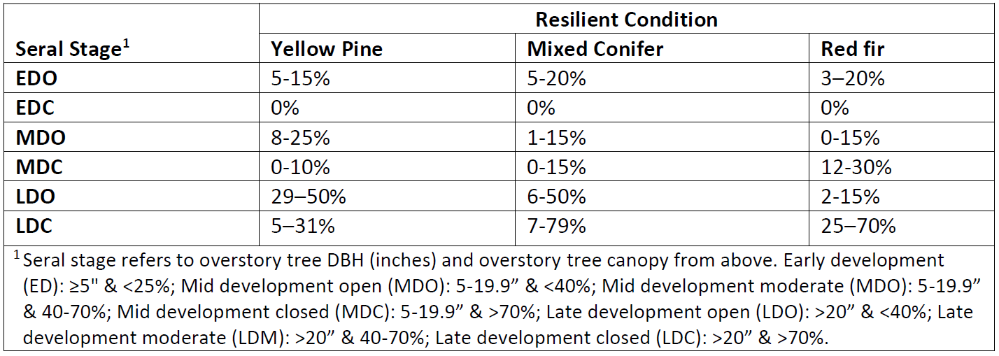

In [ ]:
fields = ['Acres', 'Seral_Class']
dictKeyAcre={}

with arcpy.da.SearchCursor(Ecobject, fields, sql_clause = (None, 'ORDER BY Seral_Class ASC')) as cursor:
    for row in cursor:
        if row[1] == None:
            continue
        if row[1] in dictKeyAcre:
            currentCount = dictKeyAcre[row[1]]
            dictKeyAcre[row[1]] = currentCount + row[0]
        else:
            dictKeyAcre[row[1]] = row[0]
x = []
y = []
for resscore in dictKeyAcre:
    x.append(resscore)
    y.append(dictKeyAcre[resscore])

data = [go.Bar(x=x, y=y,
    marker=dict(
        color=['rgb(255,255,190)', 'rgb(230,200, 0)', 'rgb(112, 168, 0)', 'rgb(76, 115, 0)', 'rgb(230,152,0)', 'rgb(168 112, 0)' ],
        line=dict(
            color=['rgb(255,255,190)', 'rgb(230,200, 0)', 
               'rgb(112, 168, 0)', 'rgb(76, 115, 0)', 'rgb(230,152,0)', 'rgb(168 112, 0)' ],
            width=1.5,
        )
    ),
    opacity=0.8
)]
layout = go.Layout(
    xaxis=dict(
        title='Seral Class',
        autotick=False,
        ticks='outside',
        tick0=0,
        dtick=1,
        ticklen=8,
        tickwidth=2,
        tickcolor='#000'
    ),
    yaxis=dict(
        title='Acres',
        )
)
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='basic-bar')

## Mean Condition Class (Mean Fire Return Interval Departure Condition Class)
Mean Condition Class is based on Fire Return Interval Departure data for condition class (Safford et al. 2011). These data quantify the difference between current and pre-settlement fire frequencies, allowing managers to target areas at high risk based on where natural fire cycles have been missed. Fire interval departure gives us an idea of where uncharacteristic fuels loads and tree densities may exist on the landscape. Areas further departed may have higher fuel loadings and are less resilient to fire, and potentially to drought as well.

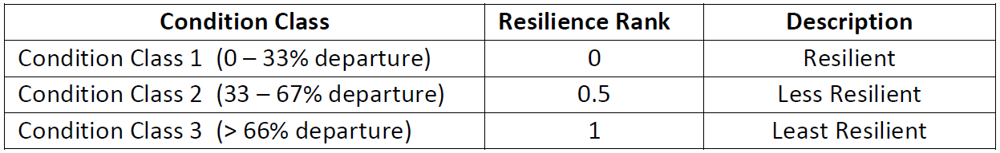

In [ ]:
# perfomr zonal stats to join Fire Return Interval data to Ecobject data and calculate the resilence score
arcpy.FeatureToRaster_conversion( projectgdb + '/FRID_NorthSierra15_1_LTW', "meanCC_FRI", 'FRID_grid', 5)
# Set local variables
inZoneData = Ecobject
zoneField = "Ecobject_ID"
inValueRaster = 'FRID_grid'
outTable = "ZonalStat_Ecobject_FRID.dbf"
# Execute ZonalStatisticsAsTable
outZSaT = arcpy.sa.ZonalStatisticsAsTable(inZoneData, zoneField, inValueRaster, outTable, "NODATA", "MAJORITY")

In [ ]:
#create dictionary
#Key: join field
#Value: field with value to be transferred
outTable = 'C:/GIS/PROJECT/LakeTahoeWest/Data/AnalysisData.gdb/ZonalStat_Ecobject_FRID'
valueDict = dict ([(key, val) for key, val in SearchCursor(outTable, ["Ecobject_ID", "MAJORITY"])])
updateFld = 'meanCC_FRID' 
IdFld = 'EcObject_ID'
#update Ecobject feature class
with UpdateCursor (Ecobject, [updateFld, IdFld]) as cursor:
    for update, key in cursor:
        #skip if key value is not in dictionary
        if not key in valueDict:
            continue
        #create row tuple
        row = (valueDict [key], key)
        #update row
        cursor.updateRow (row)
del cursor

In [ ]:
fields = ['meanCC_FRID', 'CC_Resilience_Rank']
# Create update cursor for feature class 
with UpdateCursor(Ecobject, fields) as cursor:
    # For each row, evaluate the field value (index position 
    # of 0, 1, and 2), and update field value (index position of 3)
    for row in cursor:
        # FRID Range and classification of threshold score
        if row[0] == 1:
            row[1] = 0
        elif row[0] == 2:
            row[1] = 0.5
        elif row[0] == 3:
            row[1] = 1
        elif row[0] == -999:
            row[1] = None
        elif row[0] == -2:
            row[1] = None
        cursor.updateRow(row)
    del cursor

### Results

In [ ]:
fields = ['Acres', 'CC_Resilience_Rank']
dictKeyAcre={}

with SearchCursor(Ecobject, fields, sql_clause=(None, 'ORDER BY CC_Resilience_Rank ASC')) as cursor:
    for row in cursor:
        if row[1] in dictKeyAcre:
            currentCount = dictKeyAcre[row[1]]
            dictKeyAcre[row[1]] = currentCount + row[0]
        else:
            dictKeyAcre[row[1]] = row[0]
x = []
y = []
for resscore in dictKeyAcre:
    x.append(resscore)
    y.append(dictKeyAcre[resscore])

data = [go.Bar(x=x, y=y, marker=dict(color=['rgb(40,146,199)', 'rgb(250,250,100)', 'rgb(232,16,20)'], line=dict(color=['rgb(0,76,115)', 'rgb(230,230,0)', 'rgb(168,0,0)'], width=1.5,)),opacity=0.8)]
layout = go.Layout(xaxis=dict(title='Resilience Score', autotick=False, ticks='outside', tick0=0, dtick=0.5, ticklen=8, tickwidth=2, tickcolor='#000'), yaxis=dict(title='Acres'))
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='basic-bar')

## Horizontal Heterogeneity 
Similar to vertical heterogeneity, horizontal heterogeneity spatial patterns are important resilience indicators because they influence disturbance behavior, regeneration, snow retention, and habitat quality. Heterogeneity across the landscape will increase landscape resilience. Two data sources were used to evaluate horizontal heterogeneity: 1) Illilouette Basin reference sites and 2) data from (Lydersen et al. 2013). These two sources allowed the Design Team to bracket the range of resilient conditions presented below. The resilient conditions for horizontal heterogeneity was further evaluated by landscape management unit (ridge, canyon, NE and SW slopes). (See Appendix A for additional methodological information).

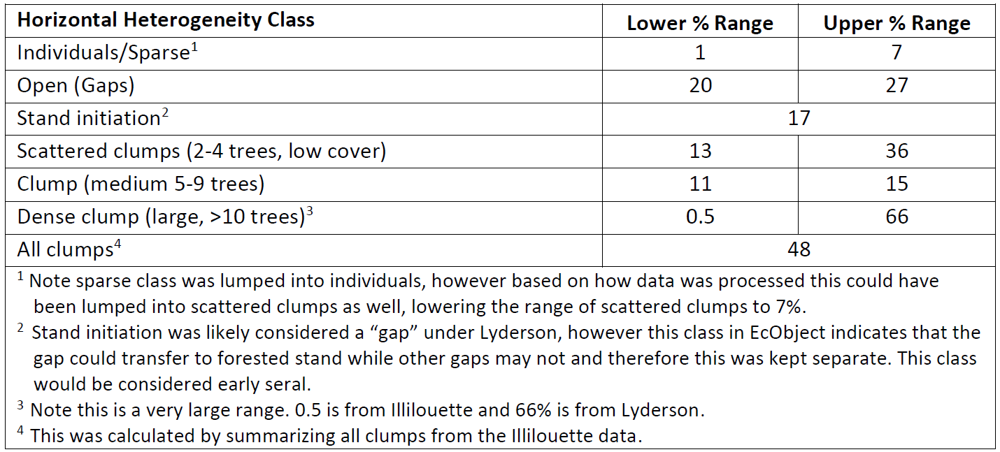

In [ ]:
fields = ['Acres', 'SpatialVar']
dictKeyAcre={}

with arcpy.da.SearchCursor(Ecobject, fields) as cursor:
    for row in cursor:
        if row[1] in dictKeyAcre:
            currentCount = dictKeyAcre[row[1]]
            dictKeyAcre[row[1]] = currentCount + row[0]
        else:
            dictKeyAcre[row[1]] = row[0]
x = []
y = []
for resscore in dictKeyAcre:
    x.append(resscore)
    y.append(dictKeyAcre[resscore])

data = [go.Bar(x=x, y=y,
    marker=dict(
        color=['rgb(40,146,199)', 'rgb(250,250,100)', 'rgb(232,16,20)'],
        line=dict(
            color=['rgb(0,76,115)', 'rgb(230,230,0)', 'rgb(168,0,0)'],
            width=1.5,
        )
    ),
    opacity=0.8, 
)]
layout = go.Layout(
    xaxis=dict(
        title='Resilience Score',
        autotick=False,
        ticks='outside',
        tick0=1,
        ticklen=8,
        tickwidth=2,
        tickcolor='#000'
    ),
    yaxis=dict(
        title='Acres', hoverformat='0.r'
        )
)
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='basic-bar')

## Trees per Acre
Trees per acre (TPA) is an indicator of resilience of upland forests and in some cases meadow/riparian ecosystems to fire, insects, disease, drought and climate change. In general, as forests become more dense (e.g., more TPA), they are less resilient to various disturbances. The acceptable resilient condition for the TPA indicator came from the published literature sources for historic and contemporary reference conditions. The range of resilience does not include associated information on tree size classes or forest seral stages. This metric does not include saplings and seedlings. 


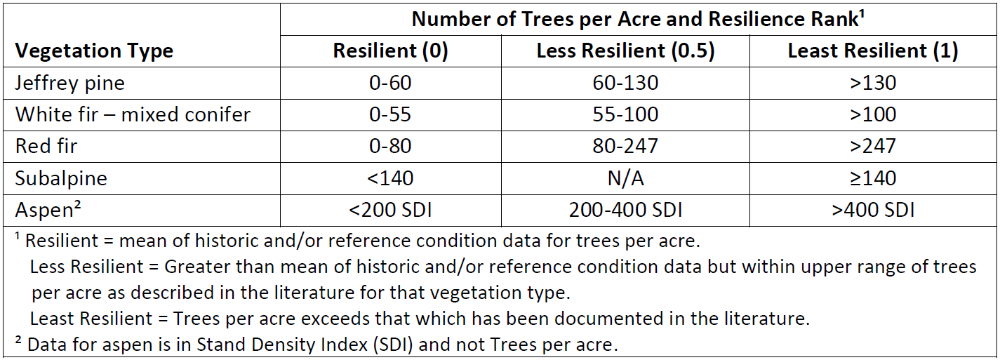

### Analysis

In [ ]:
fields = ['pTree_Count_acre', 'REGIONAL_DOMINANCE_TYPE_1', 'SDI', 'TreesPerAcre_Resilience_Rank']
# Create update cursor for feature class 
with arcpy.da.UpdateCursor(fc, fields) as cursor:
    # For each row, evaluate the field value (index position 
    # of 0, 1, and 2), and update field value (index position of 3)
    for row in cursor:
        # TPA Ranges for Jeffery Pine
        if (row[1] == 'JP' and row[0] >= 0 and row[0] <= 30):
            row[3] = 0
        elif (row[1] == 'JP' and row[0] > 30 and row[0] <= 100):
            row[3] = 0.5
        elif (row[1] == 'JP' and row[0] > 100):
            row[3] = 1
        # TPA Ranges for Mixed Conifer-Fir
        if (row[1] == 'MF' and row[0] >= 0 and row[0] <= 25):
            row[3] = 0
        elif (row[1] == 'MF' and row[0] > 25 and row[0] <= 70):
            row[3] = 0.5
        elif (row[1] == 'MF' and row[0] > 70):
            row[3] = 1
        # TPA Ranges for Red Fir
        if (row[1] == 'RF' and row[0] >= 0 and row[0] <= 50):
            row[3] = 0
        elif (row[1] == 'RF' and row[0] > 50 and row[0] <= 217):
            row[3] = 0.5
        elif (row[1] == 'RF' and row[0] > 217):
            row[3] = 1
        # TPA Ranges for Sub-Alpine
        if (row[1] == 'SA' and row[0] >= 0 and row[0] <= 110):
            row[3] = 0
        elif (row[1] == 'SA' and row[0] > 110):
            row[3] = 1
        # TPA Ranges for Aspen
        if (row[1] == 'QQ' and row[2] >= 0 and row[2] <= 200):
            row[3] = 0
        elif (row[1] == 'QQ' and row[0] > 200 and row[0] <= 400):
            row[3] = 0.5
        elif (row[1] == 'QQ' and row[0] > 400):
            row[3] = 1
        # TPA Ranges for White Fire
        if (row[1] == 'WF' and row[0] >= 0 and row[0] <= 25):
            row[3] = 0
        elif (row[1] == 'WF' and row[0] > 25 and row[0] <= 70):
            row[3] = 0.5
        elif (row[1] == 'WF' and row[0] > 70):
            row[3] = 1
        # Update the cursor with the updated list
        cursor.updateRow(row)

### Results

In [ ]:
fields = ['Acres', 'TreesPerAcre_Threshold_Score']
dictKeyAcre={}

with SearchCursor(Ecobject, fields, sql_clause = (None, 'ORDER BY TreesPerAcre_Resilience_Rank ASC')) as cursor:
    for row in cursor:
        if row[1] == None:
            continue
        if row[1] in dictKeyAcre:
            currentCount = dictKeyAcre[row[1]]
            dictKeyAcre[row[1]] = currentCount + row[0]
        else:
            dictKeyAcre[row[1]] = row[0]
x = []
y = []
for resscore in dictKeyAcre:
    x.append(resscore)
    y.append(dictKeyAcre[resscore])

data = [go.Bar(x=x, y=y,
    marker=dict(
        color=['rgb(40,146,199)', 'rgb(250,250,100)', 'rgb(232,16,20)'],
        line=dict(
            color=['rgb(0,76,115)', 'rgb(230,230,0)', 'rgb(168,0,0)'],
            width=1.5,
        )
    ),
    opacity=0.8
)]
layout = go.Layout(
    xaxis=dict(
        title='Threshold Score',
        autotick=False,
        ticks='outside',
        tick0=0,
        dtick=0.5,
        ticklen=8,
        tickwidth=2,
        tickcolor='#000'
    ),
    yaxis=dict(
        title='Acres',
        )
)
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='basic-bar')

## Climatic Water Deficit
Climatic Water Deficit (CWD) is a measure of plant stress. It is calculated as the difference between actual and potential evapotranspiration, which is limited by soil moisture availability. Multiple studies have demonstrated the sensitivity of ecosystems to climatic water deficit, which is a measure of water stress. Ecosystems with lower CWD are more resilient to ecosystem disturbance (e.g. climate change, insects and disease, fire, etc.). Recent work has shown a strong connection between resilience of drought induced beetle mortality and climatic water deficit (e.g., Restaino et al. 2017).
The Design Team used climatic water deficit for 2015, which was a significant drought year, from the California Basin Characterization Model (Flint, Lorraine E., Alan L. Flint, org: USGS). This dataset provides historical and projected climate and hydrologic surfaces for the state of California and all the streams that flow into it. (See Appendix A for additional methodological information).

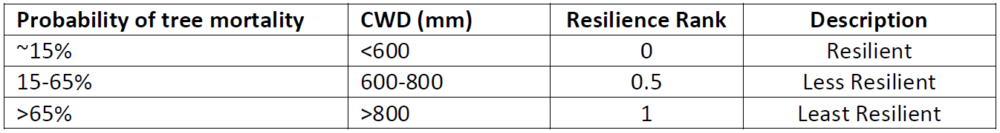

In [ ]:
# Set local variables
inZoneData = "Ecobject"
zoneField = "Ecobject_ID"
inValueRaster = "CWD_2015" 

# Execute ZonalStatistics
outZonalStatistics = ZonalStatistics(inZoneData, zoneField, inValueRaster,"MEAN", "NODATA")

# Save the output 
outZonalStatistics.save("C:/GIS/PROJECT/LakeTahoeWest/Data/AnalysisData.gdb/ZonalStat_Ecobject_CWD")

# Join and Calc
fieldJoinCalc(outZonalStatistics, 'Ecobject_ID', 'CWD', Ecobject, 'Ecobject_ID', 'grid')

# rank resilience
fields = ['', '', '', 'CWD_ThresholdScore']
# Create update cursor for feature class 
with arcpy.da.UpdateCursor(fc, fields) as cursor:
    # For each row, evaluate the field value (index position 
    # of 0, 1, and 2), and update field value (index position of 3)
    for row in cursor:
        # CWD Ranges to threshold score
        if (row[1] == '' and row[0] >= and row[0] <= ):
            row[3] = 0
        elif (row[1] == '' and row[0] > and row[0] <= ):
            row[3] = 0.5
        elif (row[1] == '' and row[0] > ):
            row[3] = 1a

In [ ]:
fields = ['Acres', 'CWD_Resilience_Rank']
dictKeyAcre={}

with SearchCursor(Ecobject, fields, sql_clause=(None,'ORDER BY CWD_Resilience_Rank ASC')) as cursor:
    for row in cursor:
        if row[1] == None:
            continue
        if row[1] in dictKeyAcre:
            currentCount = dictKeyAcre[row[1]]
            dictKeyAcre[row[1]] = currentCount + row[0]
        else:
            dictKeyAcre[row[1]] = row[0]
x = []
y = []
for resscore in dictKeyAcre:
    x.append(resscore)
    y.append(dictKeyAcre[resscore])

data = [go.Bar(x=x, y=y,
    marker=dict(
        color=['rgb(40,146,199)', 'rgb(250,250,100)', 'rgb(232,16,20)'],
        line=dict(
            color=['rgb(0,76,115)', 'rgb(230,230,0)', 'rgb(168,0,0)'],
            width=1.5,
        )
    ),
    opacity=0.8
)]
layout = go.Layout(
    xaxis=dict(
        title='Resilience Score',
        autotick=False,
        ticks='outside',
        tick0=0,
        dtick=0.5,
        ticklen=8,
        tickwidth=2,
        tickcolor='#000'
    ),
    yaxis=dict(
        title='Acres',
        )
)
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig, filename='basic-bar')

## Slope Analysis

In [ ]:
import pandas as pd
from arcgis.features import GeoAccessor, GeoSeriesAccessor

In [ ]:
dfEcobject = pd.read_csv("C:/GIS/PROJECT/ForestHealth/Data/Tahoe_Ecobject.csv")

In [ ]:
dfEcobject

In [ ]:
dfEcobject.info()

In [ ]:
# iterating the columns 
for col in dfEcobject.columns: 
    print(col) 

In [ ]:
# Stands with an average slope greater than 50%
ltwAcres= pd.pivot_table(dfEcobject,index=["LTW_Projec"], values=["Acres"],fill_value= 999, aggfunc="sum").round()
ltwAcres

In [ ]:
# Stands with an average slope greater than 50%
ltwAcres= pd.pivot_table(dfEcobject[dfEcobject.LTW_Projec == "Yes"],index=["WEPP_Cover"], values=["Acres"],fill_value= 999, aggfunc="sum").round()
ltwAcres

In [ ]:
# Stands with an average slope greater than 50%
ltwAcres= pd.pivot_table(dfEcobject,index=["WEPP_Sensi"], values=["Acres"],fill_value= 999, aggfunc="sum").round()
ltwAcres

In [ ]:
# Stands with an average slope greater than 50%
ltwAcres= pd.pivot_table(dfEcobject,index=["LTW_Projec"], values=["Acres"],fill_value= 999, aggfunc="sum").round()
ltwAcres

In [ ]:
# Stands with an average slope less than 30%
slopeAcres30= pd.pivot_table(dfEcobject[(dfEcobject.Avg_Slope<=30)],index=["LTW_Projec"], values=["Acres"],fill_value= 999, aggfunc="sum").round()
slopeAcres30

In [ ]:
# Stands with an average slope greater than 50%
slopeAcres50= pd.pivot_table(dfEcobject[dfEcobject.Avg_Slope>=50],index=["LTW_Projec"], values=["Acres"],fill_value= 999, aggfunc="sum").round()
slopeAcres50

In [ ]:
# Stands with an average slope greater than 30% and less than 50%
slopeAcres3050 = pd.pivot_table(dfEcobject[(dfEcobject.Avg_Slope>30) & (dfEcobject.Avg_Slope <50)],index=["LTW_Projec"], values=["Acres"],fill_value= 999, aggfunc="sum").round()
slopeAcres3050

In [ ]:
# Stands with an average slope greater than 30% and less than 50%
slopeAcres3050 = pd.pivot_table(dfEcobject[(dfEcobject.Avg_Slope>30) & (dfEcobject.Avg_Slope <50)],index=["LTW_Projec","Road_Proxi"], values=["Acres"],fill_value= 999, aggfunc="sum").round()
slopeAcres3050